2 Dimensional Array Manipulations and Equalization for Clarity images

In [2]:
#insert your own parth here
import os
os.chdir('/Users/albertlee/NeuroCV/Module1/PCV/2Dhisteq')

In [3]:
### Run below if necessary

##import sys

##sys.path.append('/usr/local/lib/python2.7/site-packages')

import math
import csv,gc
import matplotlib
import numpy as np
import cv2

#%matplotlib
BINS = 32

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

In [5]:
from skimage import data, img_as_float
from skimage import exposure

In [6]:
import cv2

In [7]:
from PCV import tools
from PIL import Image
from numpy import *

def histeq(im,nbr_bins=256):
    """    Histogram equalization of a grayscale image. """
    
    # get image histogram
    imhist,bins = histogram(im.flatten(),nbr_bins,normed=True)
    cdf = imhist.cumsum() # cumulative distribution function
    cdf = 255 * cdf / cdf[-1] # normalize
    
    # use linear interpolation of cdf to find new pixel values
    im2 = interp(im.flatten(),bins[:-1],cdf)
    
    return im2.reshape(im.shape), cdf

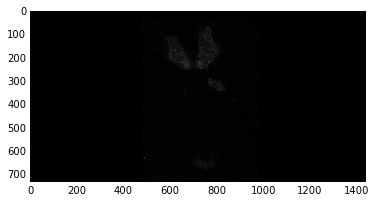

In [8]:
im = array(Image.open('Fear199.png'))
plt.imshow(np.asarray(im))

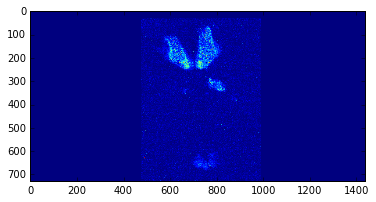

In [9]:
im = array(Image.open('Fear199.png').convert('L'))
im2,cdf = histeq(im)
plt.imshow(np.asarray(im))

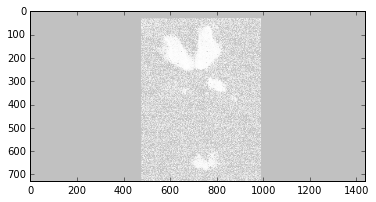

In [11]:
histeqimage = Image.fromarray(im2)
histeqimage = histeqimage.convert('RGB')
plt.imshow(np.asarray(histeqimage))

In [12]:
import math

## Import image

im = np.asarray(im)

print im
z = im

# Number of pixels
pixels = len(z) * len(z[0])
print "The number of pixels is {}".format(pixels)
## The output should be 4 since there are 4 numbers in this array

##Flatten method doesn't work because of tuple conversion later on
'''# Now we flatten Z
zz = z.reshape(-1)'''


# Initialize histogram and CDF
hist = {}
cdf = {}
norm_cdf = {}
## The range value should be be adjusted to the bin number
### In our case the range and bin number is obviously 10 
### since we generated numbers 1-10
BINS = 255

for i in range(BINS):
    hist[i] = 0
    cdf[i] = 0
    norm_cdf[i] = 0

# Create histogram


for row in z:
    for val in row:
        hist[val] += 1

'''
for val in zz:
    hist[val] += 1
'''    


# Create cdf
for i in range(BINS):
    for j in range(i+1):
        cdf[i] += hist[j]
    norm_cdf[i] = int(math.floor(float(cdf[i]-1)/63*BINS))
    
print "The histogram values are {}".format(hist)
print "The cdf values are {}".format(cdf)
print "The normalized cdf values are {}".format(norm_cdf)


[[0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 ..., 
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]
 [0 0 0 ..., 0 0 0]]
The number of pixels is 1046864
The histogram values are {0: 793273, 1: 32538, 2: 90886, 3: 0, 4: 38341, 5: 37845, 6: 0, 7: 10750, 8: 10592, 9: 0, 10: 5950, 11: 2231, 12: 2092, 13: 1921, 14: 1681, 15: 1600, 16: 1510, 17: 2776, 18: 0, 19: 1163, 20: 2038, 21: 0, 22: 883, 23: 1517, 24: 0, 25: 1333, 26: 600, 27: 0, 28: 944, 29: 447, 30: 366, 31: 326, 32: 329, 33: 274, 34: 246, 35: 407, 36: 0, 37: 198, 38: 312, 39: 0, 40: 137, 41: 221, 42: 0, 43: 178, 44: 76, 45: 0, 46: 123, 47: 53, 48: 52, 49: 43, 50: 33, 51: 28, 52: 34, 53: 53, 54: 0, 55: 22, 56: 59, 57: 0, 58: 35, 59: 16, 60: 0, 61: 27, 62: 13, 63: 0, 64: 28, 65: 8, 66: 12, 67: 9, 68: 5, 69: 8, 70: 9, 71: 12, 72: 0, 73: 11, 74: 10, 75: 0, 76: 11, 77: 3, 78: 0, 79: 8, 80: 4, 81: 0, 82: 7, 83: 3, 84: 2, 85: 3, 86: 4, 87: 6, 88: 0, 89: 2, 90: 0, 91: 2, 92: 125, 93: 0, 94: 0, 95: 0, 96: 0, 97: 0, 98: 0, 99: 0, 100: 

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0

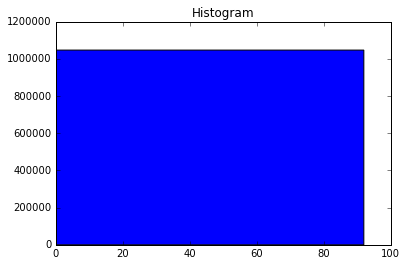

In [13]:
np.set_printoptions(threshold='nan')

imgflat = im.reshape(-1)
print imgflat
print imgflat.sum()

print " "
fig = plt.hist(imgflat, bins='auto')
plt.title('Histogram')
plt.show()


<function matplotlib.pyplot.show>

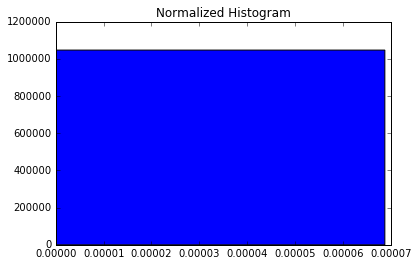

In [14]:
print " "
imgnorm = imgflat*1.0/sum(imgflat)

fig = plt.hist(imgnorm, bins = 'auto')
plt.title('Normalized Histogram')
plt.show

In [15]:
newimg = np.empty(im.shape)
## This should be the same exact dimensions as the original array
print im.shape

## set x_length to the first number, y_length to the second
x_length = im.shape[0]
y_length = im.shape[1]

print x_length, y_length

for i in range(x_length):
    for j in range(y_length):
        newimg[i][j] = norm_cdf[ im[i][j] ]

print newimg

(728, 1438)
728 1438
[[ 3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  

<function matplotlib.pyplot.show>

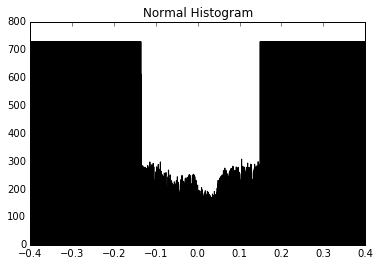

In [26]:
fig = plt.hist(im, bins = 'auto')
plt.title('Normal Histogram')
plt.show

/usr/local/lib/python2.7/site-packages/matplotlib/axes/_axes.py:5907: UserWarning: 2D hist input should be nsamples x nvariables;
 this looks transposed (shape is 728 x 1438)
  '(shape is %d x %d)' % inp.shape[::-1])


<function matplotlib.pyplot.show>

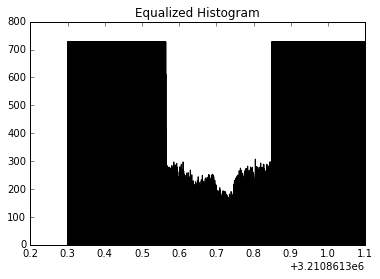

In [16]:
fig = plt.hist(newimg, bins = 'auto')
plt.title('Equalized Histogram')
plt.show

In [17]:
#728 1438
for i in range(728):
    for j in range(1438):
        newimg[i][j] = norm_cdf[ im[i][j] ]

print '+-------+-----------+-----+----------------+'
print '| %5s | %9s | %3s | %14s |' % ('Value', 'Histogram', 'cdf', 'Normalized cdf')
print '+-------+-----------+-----+----------------+'
for i in range(255):
    if hist[i] == 0: continue
    print '| %5s | %9s | %3s | %14s |' % (i, hist[i], cdf[i], norm_cdf[i])
print '+-------+-----------+-----+----------------+'

+-------+-----------+-----+----------------+
| Value | Histogram | cdf | Normalized cdf |
+-------+-----------+-----+----------------+
|     0 |    793273 | 793273 |        3210862 |
|     1 |     32538 | 825811 |        3342564 |
|     2 |     90886 | 916697 |        3710436 |
|     4 |     38341 | 955038 |        3865625 |
|     5 |     37845 | 992883 |        4018808 |
|     7 |     10750 | 1003633 |        4062320 |
|     8 |     10592 | 1014225 |        4105192 |
|    10 |      5950 | 1020175 |        4129275 |
|    11 |      2231 | 1022406 |        4138305 |
|    12 |      2092 | 1024498 |        4146773 |
|    13 |      1921 | 1026419 |        4154549 |
|    14 |      1681 | 1028100 |        4161353 |
|    15 |      1600 | 1029700 |        4167829 |
|    16 |      1510 | 1031210 |        4173941 |
|    17 |      2776 | 1033986 |        4185177 |
|    19 |      1163 | 1035149 |        4189884 |
|    20 |      2038 | 1037187 |        4198133 |
|    22 |       883 | 1038070 |      

In [18]:
print newimg

[[ 3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3210862.
   3210862.  3210862.  3210862.  3210862.  3210862.  3210862.  3

In [19]:
print ''
print 'Original subimage:'
print ''
for i in range(728):
    print ('%4d'*8) % tuple(im[i])
    


Original subimage:



TypeError: not all arguments converted during string formatting

In [20]:
print ''
print ''
print 'Equalized subimage:'
print ''

for i in range(728):
    print ('%4d'*8) % tuple(newimg[i])



Equalized subimage:



TypeError: not all arguments converted during string formatting

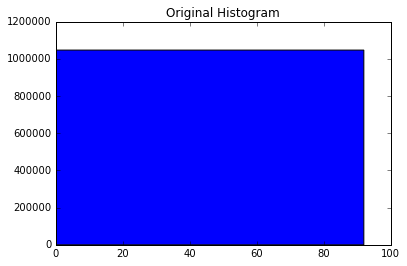

In [21]:
imgflat = im.reshape(-1)

print " "
fig = plt.hist(imgflat, bins='auto')
plt.title('Original Histogram')
plt.show()

Equalized subimage:



<function matplotlib.pyplot.show>

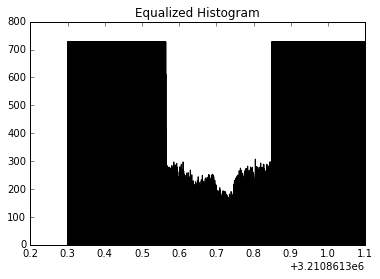

In [22]:
print 'Equalized subimage:'
print ''

fig = plt.hist(newimg, bins = 'auto')
plt.title('Equalized Histogram')
plt.show

Equalized subimage:



<function matplotlib.pyplot.show>

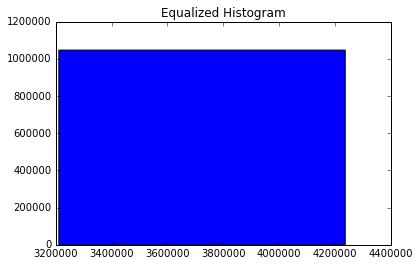

In [24]:
newimgflat = newimg.reshape(-1)

print 'Equalized subimage:'
print ''

fig = plt.hist(newimgflat, bins = 'auto')
plt.title('Equalized Histogram')
plt.show



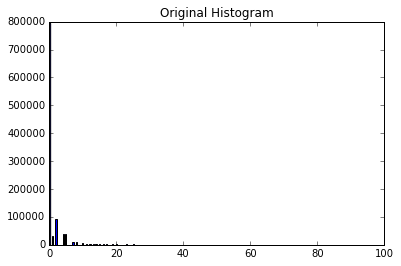

In [27]:
fig = plt.hist(imgflat, bins=255)
plt.title('Original Histogram')
plt.show()

<function matplotlib.pyplot.show>

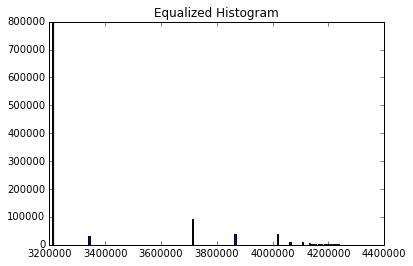

In [28]:
newimgflat = newimg.reshape(-1)
fig = plt.hist(newimgflat, bins = 255)
plt.title('Equalized Histogram')
plt.show